In [2]:
import matplotlib.pyplot as plt
import numpy as np
import powerlaw as pl
import imageio
import os

In [3]:
os.mkdir('plots')

In [4]:
os.mkdir('gifs')

In [5]:
class Sandpile():
    def __init__(self, size, stack_height):
        self.stack_height = stack_height
        self.size = size
        self.matrix = np.random.randint(low = 0, high = self.stack_height, size = (size, size))
        self.aval_times = []
        self.aval_sizes = []
        self.file_iteration = 0
        self.filenames = []
        self.current_iter = 0
        self.max_aval_time = 0
        self.iter_max_aval = 0
        self.cached_matrix = None


    def run(self, iterations, neighberhood='neumann', gif_name=None, matrix=None):
        if matrix is not None:
            self.matrix = matrix
        for i in range(iterations):
            self.current_iter = i
            x_index = np.random.randint(0, self.size)
            y_index = np.random.randint(0, self.size)
            if gif_name is not None:
                self.__save_plot(neighberhood)
            self.matrix[x_index, y_index] += 1
            if neighberhood == 'neumann':
                self.__neumann(gif_name)
            elif neighberhood == 'moore':
                self.__moore(gif_name)
            elif neighberhood == 'manhattan':
                self.__manhattan(gif_name)
        if gif_name is not None:
            self.save_animation(gif_name)
  
    def __neumann(self, gif_name):
        aval_time = 0
        avalanche_sites = np.zeros((self.size, self.size))
        matrix_copy = np.copy(self.matrix)
        if gif_name is not None:
            self.__save_plot('neumann')
        while np.max(self.matrix) >= self.stack_height:
            x, y = np.unravel_index(np.argmax(self.matrix), self.matrix.shape)
            if gif_name is not None:
                self.__save_plot('neumann')
            aval_time += 1
            self.matrix[x, y] = 0
            if x - 1 >= 0:
                self.matrix[x - 1, y] += 1
            if x + 1 < self.size:
                self.matrix[x + 1, y] += 1
            if y - 1 >= 0:
                self.matrix[x, y - 1] += 1
            if y + 1 < self.size:
                self.matrix[x, y + 1] += 1
            
            avalanche_sites[x, y] += 1
        if aval_time > 0:
            self.aval_times.append(aval_time)
            self.aval_sizes.append(np.count_nonzero(avalanche_sites))
            if aval_time > self.max_aval_time:
                self.max_aval_time = aval_time
                self.iter_max_aval = self.file_iteration
                self.cached_matrix = matrix_copy
    
    def __moore(self, gif_name):
        aval_time = 0
        avalanche_sites = np.zeros((self.size, self.size))
        if gif_name is not None:
            self.__save_plot('moore')
        while np.max(self.matrix) >= self.stack_height:
            x, y = np.unravel_index(np.argmax(self.matrix), self.matrix.shape)
            if gif_name is not None:
                self.__save_plot('moore')
            aval_time += 1
            self.matrix[x, y] = 0
            if x - 1 >= 0:
                self.matrix[x - 1, y] += 1
            if x + 1 < self.size:
                self.matrix[x + 1, y] += 1
            if y - 1 >= 0:
                self.matrix[x, y - 1] += 1
            if y + 1 < self.size:
                self.matrix[x, y + 1] += 1
            if x - 1 >= 0 and y -1 >= 0:
                self.matrix[x - 1, y - 1] += 1
            if x + 1 < self.size and y + 1 < self.size:
                self.matrix[x + 1, y + 1] += 1
            if y - 1 >= 0 and x + 1 < self.size:
                self.matrix[x + 1, y - 1] += 1
            if y + 1 < self.size and x -1 > 0:
                self.matrix[x - 1, y + 1] += 1
            
            avalanche_sites[x, y] += 1
        if aval_time > 0:
            self.aval_times.append(aval_time)
            self.aval_sizes.append(np.count_nonzero(avalanche_sites))
            
    def __manhattan(self, gif_name):
        aval_time = 0
        avalanche_sites = np.zeros((self.size, self.size))
        if gif_name is not None:
            self.__save_plot('manhattan')
        while np.max(self.matrix) >= self.stack_height:
            x, y = np.unravel_index(np.argmax(self.matrix), self.matrix.shape)
            if gif_name is not None:
                self.__save_plot('manhattan')
            aval_time += 1
            self.matrix[x, y] = 0
            if x - 1 >= 0:
                self.matrix[x - 1, y] += 1
            if x + 1 < self.size:
                self.matrix[x + 1, y] += 1
            if y - 1 >= 0:
                self.matrix[x, y - 1] += 1
            if y + 1 < self.size:
                self.matrix[x, y + 1] += 1
            if x - 1 >= 0 and y -1 >= 0:
                self.matrix[x - 1, y - 1] += 1
            if x + 1 < self.size and y + 1 < self.size:
                self.matrix[x + 1, y + 1] += 1
            if y - 1 >= 0 and x + 1 < self.size:
                self.matrix[x + 1, y - 1] += 1
            if y + 1 < self.size and x -1 > 0:
                self.matrix[x - 1, y + 1] += 1
            if x - 2 >= 0:
                self.matrix[x - 2, y] += 1
            if x + 2 < self.size:
                self.matrix[x + 2, y] += 1
            if y - 2 >= 0:
                self.matrix[x, y - 2] += 1
            if y + 2 < self.size:
                self.matrix[x, y + 2] += 1
            
            avalanche_sites[x, y] += 1

    def reset(self):
        self.matrix = np.random.randint(low = 0, high = self.stack_height, size = (size, size))
        self.filenames = []
        self.file_iteration = 0
        self.collapses = []
        
    def get_aval_sizes(self):
        return self.aval_sizes

    def __save_plot(self, neighberhood):
        plt.gray()
        plt.imshow(self.matrix, vmin = 0,vmax = self.stack_height)
        plt.colorbar()
        plt.title(f"{self.size}x{self.size} {neighberhood} iter={self.current_iter}")
        filename = f"plots/{self.file_iteration}.png"
        self.file_iteration += 1
        self.filenames.append(filename)
        plt.savefig(filename)
        plt.close()
        

    def save_animation(self, file_name):
        with imageio.get_writer(f"gifs/{file_name}", mode='I') as writer:
            for filename in self.filenames:
                image = imageio.imread(filename)
                writer.append_data(image)
        for filename in set(self.filenames):
            os.remove(filename)



**Zasymuluj proces usypywania ziaren dla kratownic 10×10 oraz 100×100. Przedstaw  stan  kratownicy  za  pomocą  obrazu  (skala  kolorów  odzwierciedla  aktualną liczbę ziaren - zastosuj 4 odcienie skali szarości)**

* 10x10 rozmiar. 20 iteracji

In [36]:
sandpile = Sandpile(10, 4)
sandpile.run(20, gif_name="10x10neumann.gif")

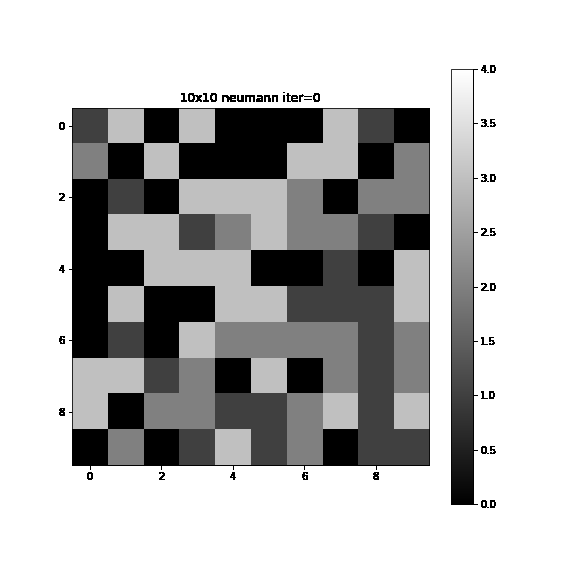

* 100x100 rozmiar. 50 iteracji

In [37]:
sandpile = Sandpile(100, 4)
sandpile.run(50, gif_name='100x100noumann.gif')

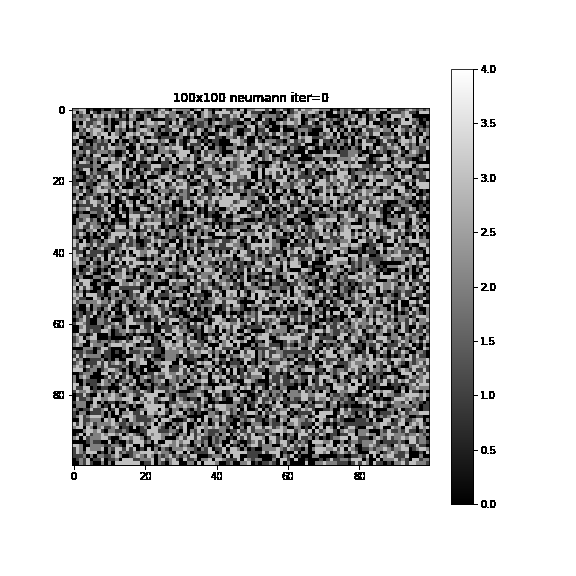

* Przeprowadź sekwencję symulacji usypywania ziaren dla różnych stanów początkowych kratownicy. Na wykresie w skali log-log przedstaw liczbę N obserwowanych lawin o rozmiarze s. Dopasuj prostą do punktów i oblicz jej wpółczynnik nachylenia α. Czy wyznaczona zależność jest potęgowa?

In [13]:
sandpile = Sandpile(100, 4)
sandpile.run(20000)

In [18]:
aval_sizes = sorted(sandpile.get_aval_sizes())
aval_sizes_set = sorted(set(aval_sizes))
occurences = []
for size in aval_sizes_set:
    occurences.append(len(list(filter(lambda aval_size: aval_size == size, aval_sizes))))
fit = pl.Fit(occurences, discrete=True, xmin=1, xmax=max(aval_sizes_set))
alpha = -fit.power_law.alpha

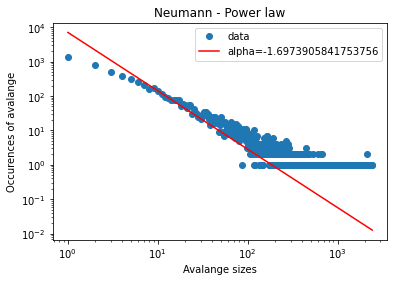

In [21]:
x_range = np.arange(1, max(aval_sizes_set))
plt.loglog(list(aval_sizes_set), occurences, linestyle="",marker="o")
plt.plot(x_range, sum(occurences)*(x_range**alpha), color='r')
plt.title("Neumann - Power law")
plt.xlabel("Avalange sizes")
plt.ylabel("Occurences of avalange")
plt.gca().legend(('data',f'alpha={alpha}'))
plt.show()

Tak, widać na wykresie że zależność jest potęgowa

In [22]:
print(f"alfa={alpha}")

alfa=-1.6973905841753756


* Od jakiej (w przybliżeniu) wartości ti mamy do czynienia ze stanem stacjonarnym(przedstaw wizualizację stanu kratownicy), w którym występują długie lawiny o dużych rozmiarach (rzędu wielkości kratownicy)?

In [6]:
sandpile = Sandpile(10, 4)
sandpile.run(20000)

In [10]:
print(f"ti={np.mean(sandpile.aval_times)}")

ti=9.74673664378953


Od wartosci (w przybliżeniu) ti=10 dla macierzy 10x10 mamy do czynienia ze stanem stacjonarnym

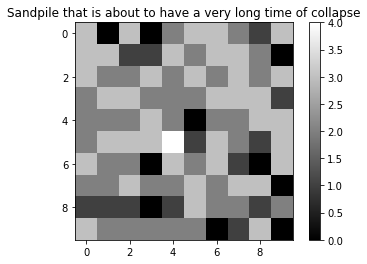

In [12]:
plt.gray()
plt.imshow(sandpile.cached_matrix, vmin = 0,vmax = 4)
plt.colorbar()
plt.title("Sandpile that is about to have a very long time of collapse")
plt.show()

Na górze jest obrazek wizualizacji stanu kratownicy, w którym występują długie lawiny o dużych rozmiarach

* Przygotuj animowane GIFy z 5 przykładowymi lawinami dla 2 różnych rozmiarów kratownic (pokaż na nich największe lawiny oraz lawiny średniej wielkości)

- 50x50 macierz. Największa lawina

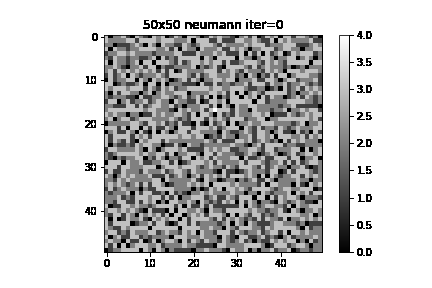

- 50x50 macierz. Srednia lawina

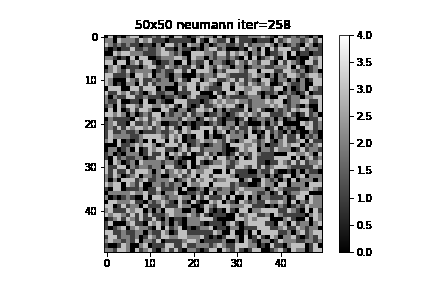

- 10x10 macierz. Największe lawiny

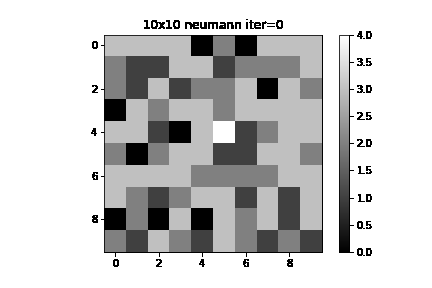

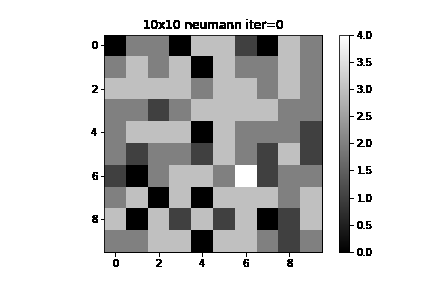

- 10x10 macierz. Średnia lawina

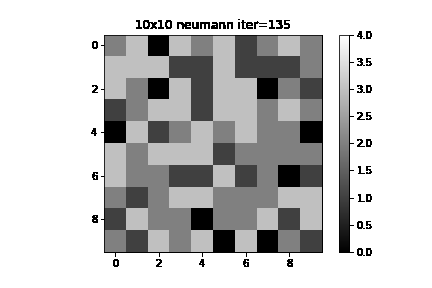

* Czy wykładnik α zmienia się po zmianie parametrów modelu?

– Maksymalna wysokość stosu: 6 (nie wiem czy 6 to prawidlowa wysokosc stosu, poniewaz po pewnym momencie lawina się nie będzie zatrzymywała. Ustawiłem 7 jako wysokośc stosu), sąsiedztwo Moore’a


In [29]:
sandpile = Sandpile(100, 8)
sandpile.run(20000, neighberhood='moore')

In [30]:
aval_sizes = sorted(sandpile.get_aval_sizes())
aval_sizes_set = sorted(set(aval_sizes))
occurences = []
for size in aval_sizes_set:
    occurences.append(len(list(filter(lambda aval_size: aval_size == size, aval_sizes))))
fit = pl.Fit(occurences, discrete=True, xmin=1, xmax=max(aval_sizes_set))
alpha = -fit.power_law.alpha

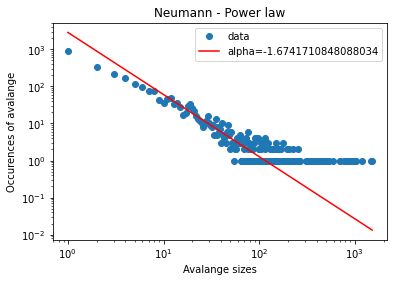

In [31]:
x_range = np.arange(1, max(aval_sizes_set))
plt.loglog(list(aval_sizes_set), occurences, linestyle="",marker="o")
plt.plot(x_range, sum(occurences)*(x_range**alpha), color='r')
plt.title("Neumann - Power law")
plt.xlabel("Avalange sizes")
plt.ylabel("Occurences of avalange")
plt.gca().legend(('data',f'alpha={alpha}'))
plt.show()

In [32]:
print(f"alfa={alpha}")

alfa=-1.6741710848088034



– Maksymalna wysokość stosu: 10(nie wiem czy 10 to prawidlowa wysokosc stosu, poniewaz po pewnym momencie lawina się nie będzie zatrzymywała. Ustawiłem 11 jako wysokośc stosu), Manhattan distance r = 2

In [33]:
sandpile = Sandpile(100, 12)
sandpile.run(20000, neighberhood='manhattan')

In [34]:
aval_sizes = sorted(sandpile.get_aval_sizes())
aval_sizes_set = sorted(set(aval_sizes))
occurences = []
for size in aval_sizes_set:
    occurences.append(len(list(filter(lambda aval_size: aval_size == size, aval_sizes))))
fit = pl.Fit(occurences, discrete=True, xmin=1, xmax=max(aval_sizes_set))
alpha = -fit.power_law.alpha

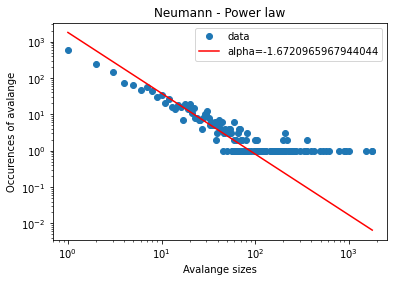

In [35]:
x_range = np.arange(1, max(aval_sizes_set))
plt.loglog(list(aval_sizes_set), occurences, linestyle="",marker="o")
plt.plot(x_range, sum(occurences)*(x_range**alpha), color='r')
plt.title("Neumann - Power law")
plt.xlabel("Avalange sizes")
plt.ylabel("Occurences of avalange")
plt.gca().legend(('data',f'alpha={alpha}'))
plt.show()

In [36]:
print(f"alfa={alpha}")

alfa=-1.6720965967944044


Dla sąsiedstwa Neumanna α=--1.6973905841753756, dla Moora α=-1.6741710848088034, a dla Manhattana α=-1.6720965967944044. Alfa się nieco zmieniło, ale nie znacząco. Dla Moora i Manhattana są prawie identyczne
 